In [0]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np
from matplotlib import pyplot as plt

In [0]:
from google.colab import drive

In [10]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [71]:
img = cv2.imread('/content/drive/My Drive/trees-in-park-257360.jpg')
print(img)

[[[ 52  83 128]
  [ 52  85 131]
  [ 46  77 128]
  ...
  [ 12  90  89]
  [ 10  93  84]
  [ 22 107  93]]

 [[  0  22  63]
  [ 42  67 109]
  [ 64  95 140]
  ...
  [  0  69  67]
  [  8  87  76]
  [  0  81  68]]

 [[  0   6  36]
  [  6  21  53]
  [ 45  74 105]
  ...
  [ 10  80  73]
  [  9  83  71]
  [  0  62  48]]

 ...

 [[  7  54  32]
  [ 12  61  39]
  [  1  54  34]
  ...
  [  0  79  50]
  [  0  73  42]
  [  0  71  41]]

 [[ 15  75  51]
  [ 21  81  57]
  [ 14  73  52]
  ...
  [  9  91  62]
  [  9  85  54]
  [  6  80  50]]

 [[  9  80  53]
  [ 18  86  61]
  [ 27  92  70]
  ...
  [  3  85  56]
  [  0  74  43]
  [  0  66  36]]]


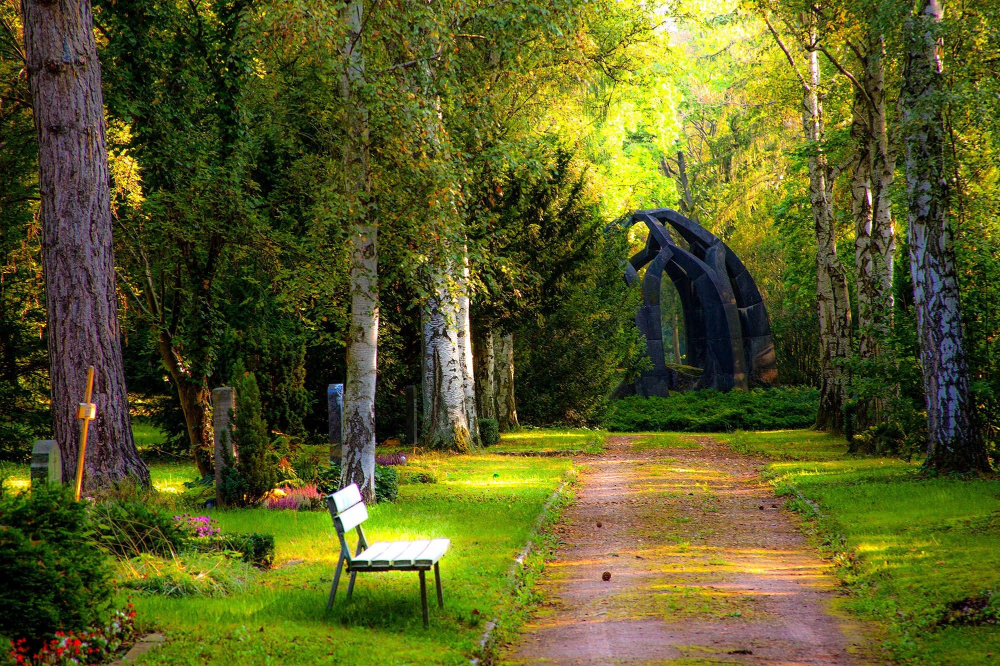

In [72]:
cv2_imshow(img)
cv2.waitKey(0)
cv2.destroyAllWindows()

In [73]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [0]:
hist, bins = np.histogram(img.flatten(), 256, [0, 256])
#print(hist) 106856 items in bin 1
#print(bins) shows total bins i.e 256
cdf = hist.cumsum()
#cdf
cdf_normalized = cdf*hist.max()/cdf.max()
#cdf_normalized

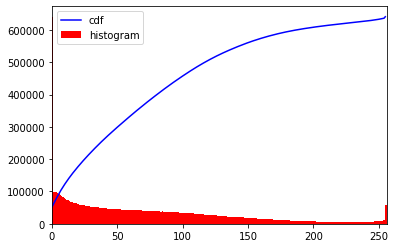

In [75]:
plt.plot(cdf_normalized, color='b')
plt.hist(img.flatten(), 256, [0, 256], color='r')
plt.xlim([0, 256])
plt.legend(('cdf', 'histogram'), loc='upper left')
plt.show()

In [0]:
cdf_m = np.ma.masked_equal(cdf, 0)
cdf_m = (cdf_m - cdf.min())*155/(cdf_m.max()-cdf_m.min())
cdf = np.ma.filled(cdf_m, 0).astype('uint8')

In [0]:
img2 = cdf[img]

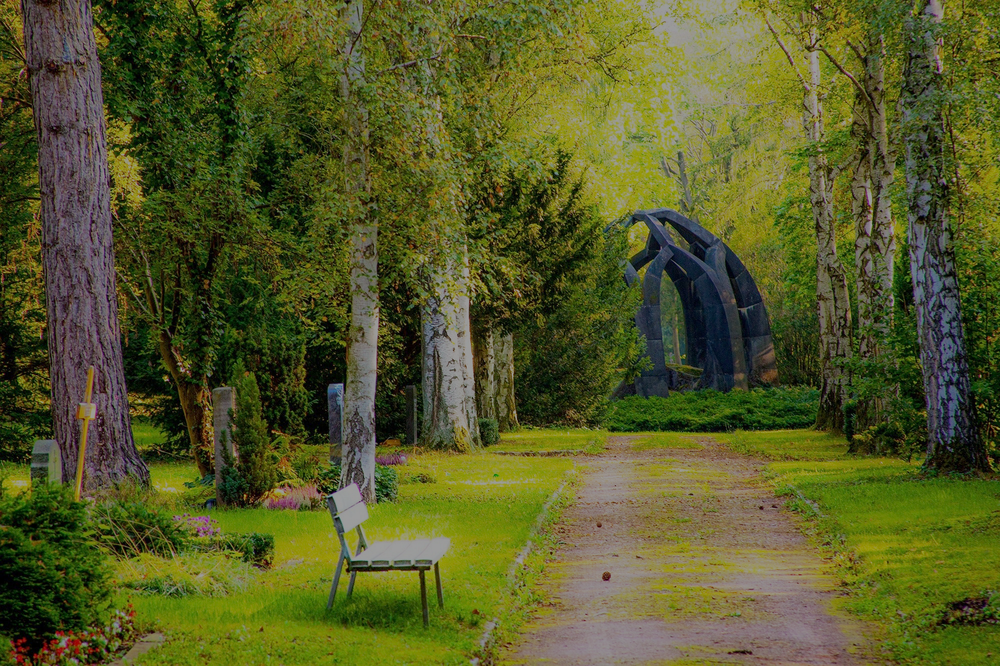

In [78]:
cv2_imshow(img2)
cv2.waitKey(0)
cv2.destroyAllWindows()

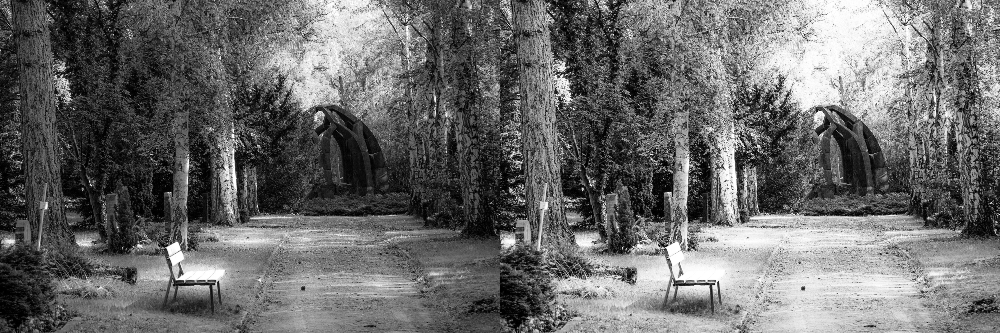

In [82]:
image_1 = cv2.imread('/content/drive/My Drive/trees-in-park-257360.jpg')
gray_image_1 = cv2.cvtColor(image_1, cv2.COLOR_BGR2GRAY)
image_1_equl = cv2.equalizeHist(gray_image_1)
result = np.hstack((gray_image_1, image_1_equl))

cv2_imshow(result)
cv2.waitKey(0)
cv2.destroyAllWindows()

In [0]:
image_2 = cv2.imread('/content/drive/My Drive/trees-in-park-257360.jpg', 1)
b, g, r = cv2.split(image_2)

equl_b = cv2.equalizeHist(b)
equl_g = cv2.equalizeHist(g)
equl_r = cv2.equalizeHist(r)

result_b = np.hstack((b, equl_b))
result_g = np.hstack((g, equl_g))
result_r = np.hstack((r, equl_r))
equl_image_2 = cv2.merge((equl_b, equl_g, equl_r))

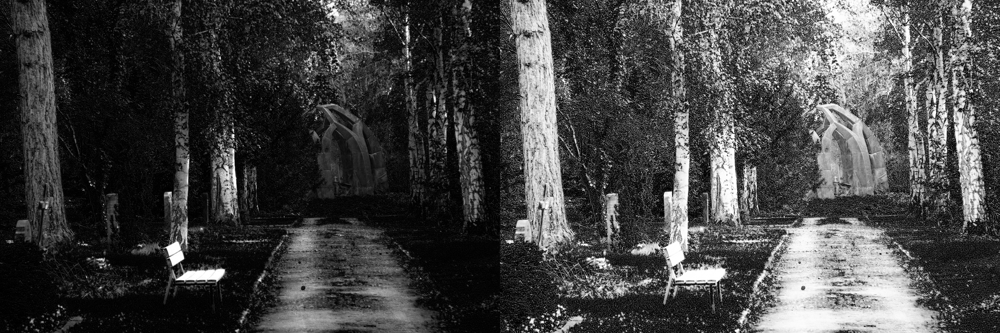

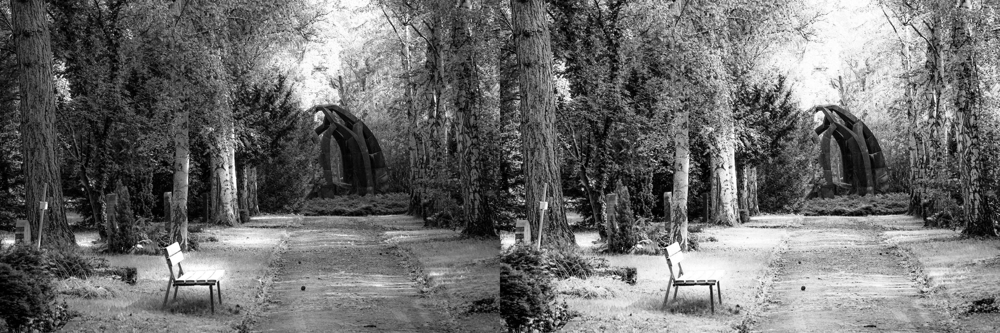

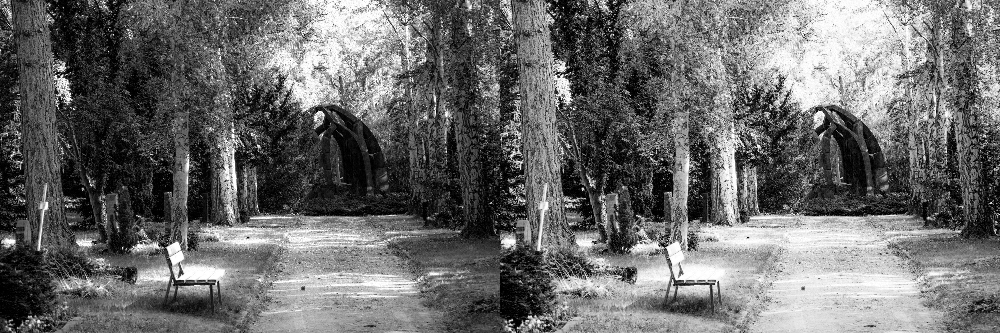

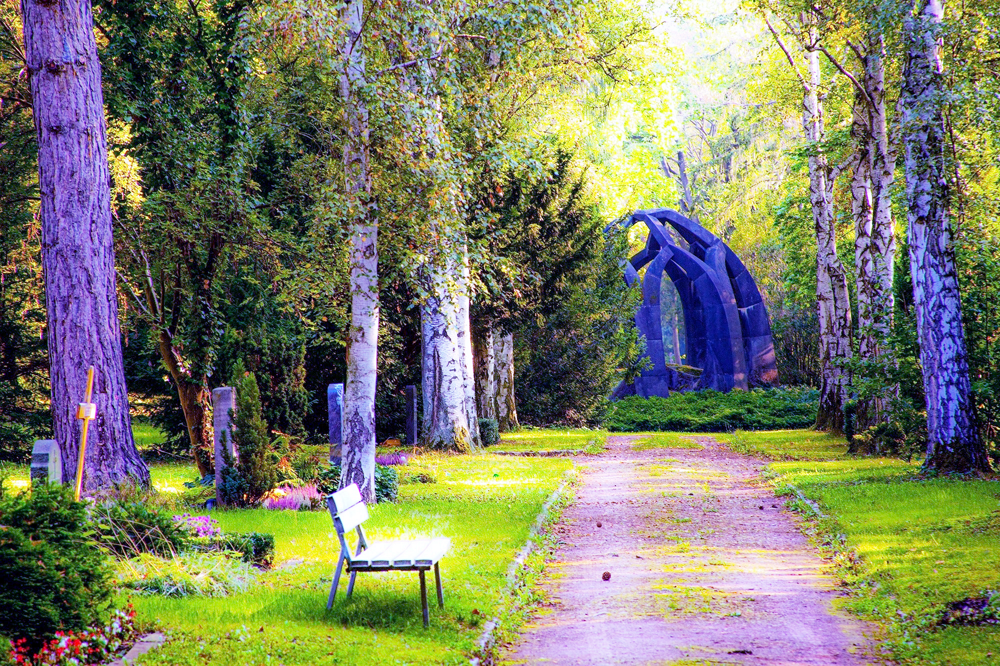

In [84]:
cv2_imshow(result_b)
cv2_imshow(result_g)
cv2_imshow(result_r)
cv2_imshow(equl_image_2)

# Images being bright has to do with the amplitude of their signal
# while them having low contrast is a fault in the signal’s frequency. 